In [14]:
# Import Libs
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
import graphviz
import copy
import numpy
import time
import sys
import altair as alt
import plotly.express as px

from sklearn import datasets, tree
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from sklearn.cluster import DBSCAN
from sklearn import metrics
from sklearn.cluster import KMeans
from sklearn.neighbors import LocalOutlierFactor
from os import system
from IPython.display import Image
from sklearn.decomposition import PCA

from sklearn.cluster import KMeans
from sklearn import metrics
from scipy.spatial.distance import cdist
import numpy as np
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors
import altair as alt

%matplotlib inline
numpy.set_printoptions(threshold=sys.maxsize)

In [15]:
# Import the data and name the collums, clear NA
adultDf = pd.read_csv("adult.data",header=None, index_col=False, 
                      names=['age', 'workclass', 'fnlwgt', "education", "education_num", 
                             "martial-stat", "occupation", "relationship", "race", "sex", 
                             "cap-gains", "cap_loss", "hpw", "native_country", "50k"])
adultDf = adultDf.dropna()

## In this Notebook we try the clustering with the following approach: 
1. Turn all categorical variables to numeric using factorize
2. Standardize all variables between 0 - 30
3. Apply PCA on the dataset and extend the dataset with 3 new columns: the first 3 pricipal component values of the datapoint
4. Find the optimal k for the k-means clustering only for the first 3 pca components. 
5. Apply k-means for the first 3 principle components 
6. Visualize differnt combinations of the dataset variables and try to interpret the clusters found with by applying k-means on the first 3 principle components

In [58]:
# >50k -> 1, <=50k ->0
adultDf['50k'] = adultDf['50k'].replace(to_replace=' >50K', value=1)
adultDf['50k'] = adultDf['50k'].replace(to_replace=' <=50K', value=0)

adultData = adultDf.copy()


# Remove fnlwgt(uncorelated) and education (doube data)
adultData.drop("fnlwgt", axis=1, inplace=True)
adultData.drop("education", axis=1, inplace=True)
adultData.drop("cap-gains", axis=1, inplace=True)
adultData.drop("cap_loss", axis=1, inplace=True)
adultData.drop("native_country", axis=1, inplace=True)

adultDatalabels = adultData["50k"]
adultData.drop('50k', axis=1, inplace=True)

cat_columns = adultData.select_dtypes(['object']).columns
adultData[cat_columns] = adultData[cat_columns].apply(lambda x: pd.factorize(x)[0])

adultData['education_num'] = adultData['education_num'].apply(lambda x: x/13*30)

column = adultData["age"]
max_age = column.max()
adultData['age'] = adultData['age'].apply(lambda x: x/max_age*30)

column = adultData["hpw"]
max_hpw = column.max()
adultData['hpw'] = adultData['hpw'].apply(lambda x: x/max_hpw*30)

column = adultData["workclass"]
max_hpw = column.max()
adultData['workclass'] = adultData['workclass'].apply(lambda x: x/max_hpw*30)

column = adultData["martial-stat"]
max_hpw = column.max()
adultData['martial-stat'] = adultData['martial-stat'].apply(lambda x: x/max_hpw*30)

column = adultData["occupation"]
max_hpw = column.max()
# replace occupation as an numerical variable by distribiution of people over 50k income, we calculated those percentages in project 1.
adultDf['occupation'] = adultDf['occupation'].replace(to_replace=' ?', value=10.36 )
adultDf['occupation'] = adultDf['occupation'].replace(to_replace=' Adm-clerical', value=13.45 )
adultDf['occupation'] = adultDf['occupation'].replace(to_replace=' Armed-Forces', value=11.11 )
adultDf['occupation'] = adultDf['occupation'].replace(to_replace=' Craft-repair', value=22.66 )
adultDf['occupation'] = adultDf['occupation'].replace(to_replace=' Exec-managerial', value=48.40 )
adultDf['occupation'] = adultDf['occupation'].replace(to_replace=' Farming-fishing', value=11.57 )
adultDf['occupation'] = adultDf['occupation'].replace(to_replace=' Handlers-cleaners', value=6.28 )
adultDf['occupation'] = adultDf['occupation'].replace(to_replace=' Machine-op-inspct', value=12.49 )
adultDf['occupation'] = adultDf['occupation'].replace(to_replace=' Other-service', value=4.16 )
adultDf['occupation'] = adultDf['occupation'].replace(to_replace=' Priv-house-serv', value=0.67 )
adultDf['occupation'] = adultDf['occupation'].replace(to_replace=' Prof-specialty', value=44.90 )
adultDf['occupation'] = adultDf['occupation'].replace(to_replace=' Protective-serv', value=32.51 )
adultDf['occupation'] = adultDf['occupation'].replace(to_replace=' Sales', value=26.93 )
adultDf['occupation'] = adultDf['occupation'].replace(to_replace=' Tech-support', value=30.50 )
adultDf['occupation'] = adultDf['occupation'].replace(to_replace=' Transport-moving', value=20.04 )

adultData['occupation'] = adultData['occupation'].apply(lambda x: x/max_hpw*30)

column = adultData["relationship"]
max_hpw = column.max()
adultData['relationship'] = adultData['relationship'].apply(lambda x: x/max_hpw*30)

column = adultData["race"]
max_hpw = column.max()
adultData['race'] = adultData['race'].apply(lambda x: x/max_hpw*30)

column = adultData["sex"]
max_hpw = column.max()
adultData['sex'] = adultData['sex'].apply(lambda x: x/max_hpw*30)

In [59]:
X_test = adultData.copy()
#X_test = adultData.copy()
pca = PCA(n_components=6)
#mds = MDS(n_components=dim, dissimilarity='precomputed', random_state=0)

principalComponents = pca.fit_transform(X_test)

principalDf = pd.DataFrame(data = principalComponents
             , columns = ['pca1', 'pca2', 'pca3', 'pca4', 'pca5', 'pca6'])

adultData = pd.concat([adultData, principalDf], axis = 1)

fig = px.scatter_3d(adultData, x='pca2', y='pca1', z='pca3')
fig.show()

principalComponents = pca.fit_transform(X_test)
pcadf = pd.DataFrame(data = principalComponents, columns = ['pca1', 'pca2', 'pca3','pca4', 'pca5', 'pca6'])

In [47]:
# Test epsilon
K = range(1, 20)
ehomogenity = []
esilluete = []
enoisenumber = []
eclusternumber = []
for k in K:
    # Building and fitting the model
    clustering_DBSCAN = DBSCAN(eps=k/2, min_samples=55, metric='euclidean').fit(pcadf)
    labels = clustering_DBSCAN.labels_   
    
    n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
    n_noise_ = list(labels).count(-1)
    n_homo = metrics.homogeneity_score(adultDatalabels, labels)
    n_sense = metrics.silhouette_score(adultData, labels)
    
    ehomogenity.append( n_homo )
    esilluete.append( n_sense )
    enoisenumber.append( n_noise_ )
    eclusternumber.append( n_clusters_ )
    print("K = " + str(K) +  " and k = " + str(k) + " and Epsilon " + str( k/4) )
    print("Estimated number of clusters: %d" % n_clusters_)
    print("Estimated number of noise points: %d" % n_noise_)
    print("Homogeneity: %0.3f" % n_homo )
    print("Silhouette Coefficient: %0.3f" % n_sense )

K = range(1, 20) and k = 1 and Epsilon 0.25
Estimated number of clusters: 14
Estimated number of noise points: 29359
Homogeneity: 0.044
Silhouette Coefficient: -0.507
K = range(1, 20) and k = 2 and Epsilon 0.5
Estimated number of clusters: 44
Estimated number of noise points: 24399
Homogeneity: 0.114
Silhouette Coefficient: -0.452
K = range(1, 20) and k = 3 and Epsilon 0.75
Estimated number of clusters: 32
Estimated number of noise points: 18574
Homogeneity: 0.186
Silhouette Coefficient: -0.254
K = range(1, 20) and k = 4 and Epsilon 1.0
Estimated number of clusters: 35
Estimated number of noise points: 15027
Homogeneity: 0.212
Silhouette Coefficient: -0.205
K = range(1, 20) and k = 5 and Epsilon 1.25
Estimated number of clusters: 43
Estimated number of noise points: 10954
Homogeneity: 0.237
Silhouette Coefficient: -0.132
K = range(1, 20) and k = 6 and Epsilon 1.5
Estimated number of clusters: 38
Estimated number of noise points: 8739
Homogeneity: 0.241
Silhouette Coefficient: -0.060
K 

range(1, 20)
[0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, 4.5, 5.0, 5.5, 6.0, 6.5, 7.0, 7.5, 8.0, 8.5, 9.0, 9.5]


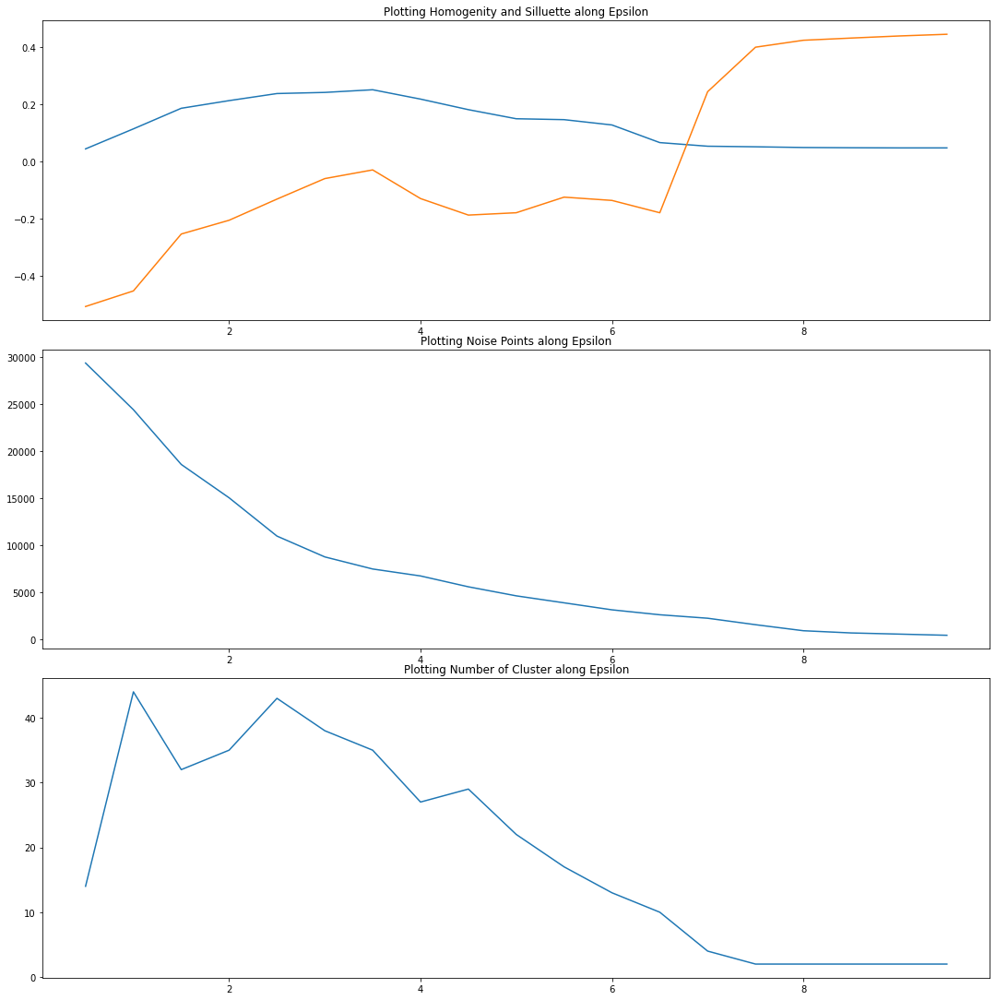

In [48]:
def transformK(KK):
    return KK/2
print(K)
epsil = list(map(transformK, K))
print(epsil)
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(15,15))
fig.tight_layout()

ax1.plot(epsil, ehomogenity )
ax1.plot(epsil, esilluete )
ax1.set_title('Plotting Homogenity and Silluette along Epsilon')

ax2.plot(epsil, enoisenumber )
ax2.set_title('Plotting Noise Points along Epsilon')

ax3.plot(epsil, eclusternumber )
ax3.set_title('Plotting Number of Cluster along Epsilon')


plt.show()

In [49]:
# Test epsilon around 3
K = range(0, 16)
ehomogenity = []
esilluete = []
enoisenumber = []
eclusternumber = []
for k in K:
    # Building and fitting the model
    clustering_DBSCAN = DBSCAN(eps=2.5+k/10, min_samples=55, metric='euclidean').fit(pcadf)
    labels = clustering_DBSCAN.labels_   
    
    n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
    n_noise_ = list(labels).count(-1)
    n_homo = metrics.homogeneity_score(adultDatalabels, labels)
    n_sense = metrics.silhouette_score(adultData, labels)
    
    ehomogenity.append( n_homo )
    esilluete.append( n_sense )
    enoisenumber.append( n_noise_ )
    eclusternumber.append( n_clusters_ )
    print("K = " + str(K) +  " and k = " + str(k) + " and Epsilon " + str( 2.5+k/10 ) )
    print("Estimated number of clusters: %d" % n_clusters_)
    print("Estimated number of noise points: %d" % n_noise_)
    print("Homogeneity: %0.3f" % n_homo )
    print("Silhouette Coefficient: %0.3f" % n_sense )

K = range(0, 16) and k = 0 and Epsilon 2.5
Estimated number of clusters: 43
Estimated number of noise points: 10954
Homogeneity: 0.237
Silhouette Coefficient: -0.132
K = range(0, 16) and k = 1 and Epsilon 2.6
Estimated number of clusters: 45
Estimated number of noise points: 10413
Homogeneity: 0.238
Silhouette Coefficient: -0.133
K = range(0, 16) and k = 2 and Epsilon 2.7
Estimated number of clusters: 46
Estimated number of noise points: 9787
Homogeneity: 0.241
Silhouette Coefficient: -0.120
K = range(0, 16) and k = 3 and Epsilon 2.8
Estimated number of clusters: 43
Estimated number of noise points: 9436
Homogeneity: 0.240
Silhouette Coefficient: -0.109
K = range(0, 16) and k = 4 and Epsilon 2.9
Estimated number of clusters: 39
Estimated number of noise points: 8979
Homogeneity: 0.240
Silhouette Coefficient: -0.083
K = range(0, 16) and k = 5 and Epsilon 3.0
Estimated number of clusters: 38
Estimated number of noise points: 8739
Homogeneity: 0.241
Silhouette Coefficient: -0.060
K = rang

range(0, 16)
[2.5, 2.6, 2.7, 2.8, 2.9, 3.0, 3.1, 3.2, 3.3, 3.4, 3.5, 3.6, 3.7, 3.8, 3.9, 4.0]


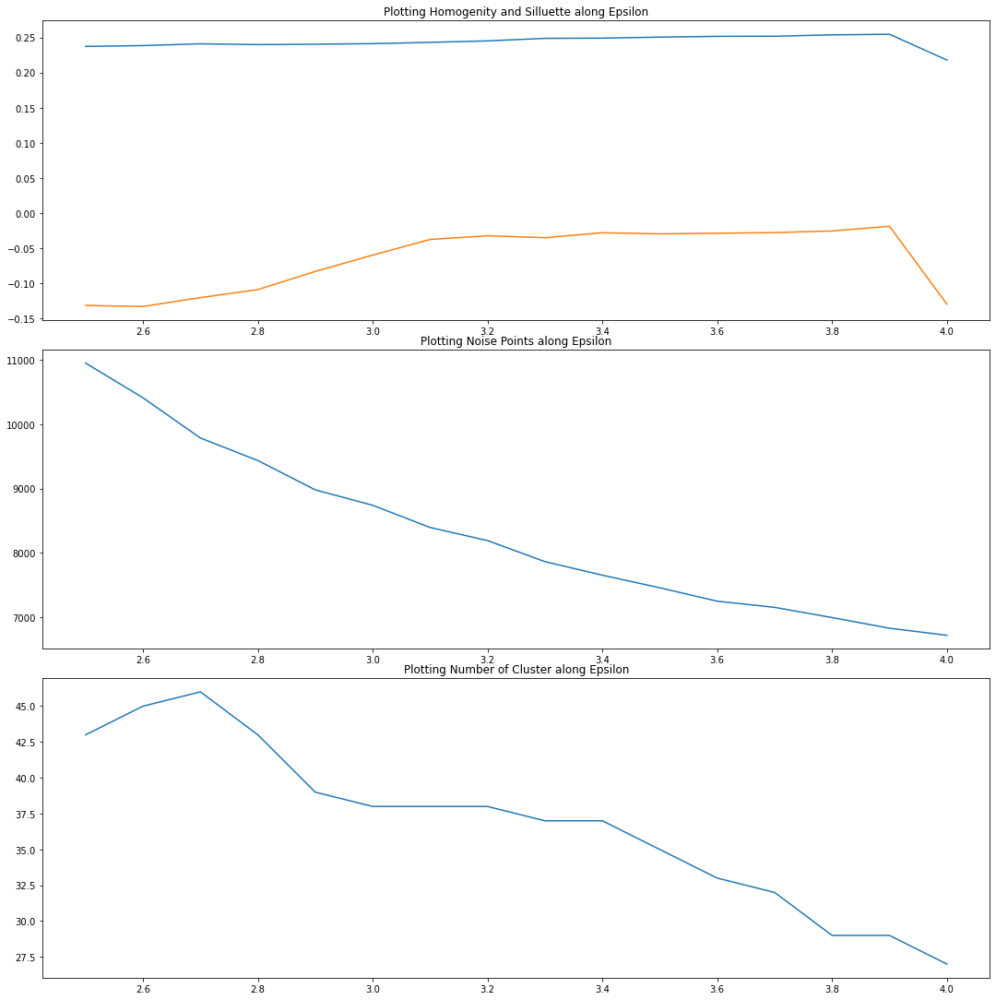

In [50]:
def transformK(KK):
    return 2.5+KK/10
print(K)
epsil = list(map(transformK, K))
print(epsil)
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(15,15))
fig.tight_layout()

ax1.plot(epsil, ehomogenity )
ax1.plot(epsil, esilluete )
ax1.set_title('Plotting Homogenity and Silluette along Epsilon')

ax2.plot(epsil, enoisenumber )
ax2.set_title('Plotting Noise Points along Epsilon')

ax3.plot(epsil, eclusternumber )
ax3.set_title('Plotting Number of Cluster along Epsilon')


plt.show()

In [45]:
# Test Min-Num-Samples
K = range(1, 20)
homogenity = []
silluete = []
noisenumber = []
clusternumber = []
for k in K:
    # Building and fitting the model
    clustering_DBSCAN = DBSCAN(eps=3.9, min_samples=k*5, metric='euclidean').fit(pcadf)
    labels = clustering_DBSCAN.labels_   
    
    n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
    n_noise_ = list(labels).count(-1)
    n_homo = metrics.homogeneity_score(adultDatalabels, labels)
    n_sense = metrics.silhouette_score(adultData, labels)
    
    homogenity.append( n_homo )
    silluete.append( n_sense )
    noisenumber.append( n_noise_ )
    clusternumber.append( n_clusters_ )
    print("K = " + str(K) +  " and k = " + str(k) + " and min-samples is " + str( 5*k ) )
    print("Estimated number of clusters: %d" % n_clusters_)
    print("Estimated number of noise points: %d" % n_noise_)
    print("Homogeneity: %0.3f" % n_homo )
    print("Silhouette Coefficient: %0.3f" % n_sense )

K = range(1, 20) and k = 1 and min-samples is 5
Estimated number of clusters: 135
Estimated number of noise points: 1412
Homogeneity: 0.278
Silhouette Coefficient: 0.004
K = range(1, 20) and k = 2 and min-samples is 10
Estimated number of clusters: 88
Estimated number of noise points: 2401
Homogeneity: 0.274
Silhouette Coefficient: -0.022
K = range(1, 20) and k = 3 and min-samples is 15
Estimated number of clusters: 62
Estimated number of noise points: 3212
Homogeneity: 0.270
Silhouette Coefficient: -0.031
K = range(1, 20) and k = 4 and min-samples is 20
Estimated number of clusters: 49
Estimated number of noise points: 3830
Homogeneity: 0.269
Silhouette Coefficient: -0.037
K = range(1, 20) and k = 5 and min-samples is 25
Estimated number of clusters: 45
Estimated number of noise points: 4395
Homogeneity: 0.267
Silhouette Coefficient: -0.044
K = range(1, 20) and k = 6 and min-samples is 30
Estimated number of clusters: 43
Estimated number of noise points: 4957
Homogeneity: 0.265
Silhou

range(1, 20)
[5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95]


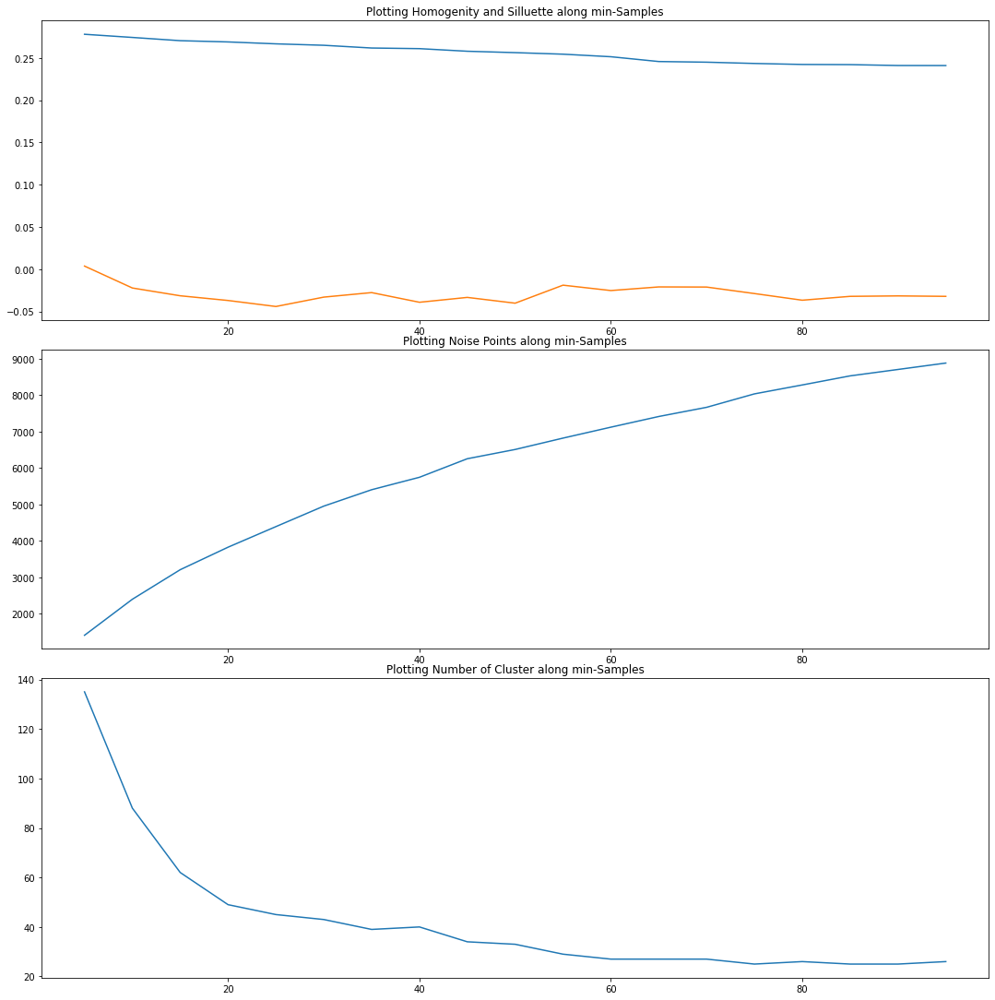

In [46]:
def transformK(KK):
    return KK*5
print(K)
minS = list(map(transformK, K))
print(minS)
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(15,15))
fig.tight_layout()

ax1.plot(minS, homogenity )
ax1.plot(minS, silluete )
ax1.set_title('Plotting Homogenity and Silluette along min-Samples')

ax2.plot(minS, noisenumber )
ax2.set_title('Plotting Noise Points along min-Samples')

ax3.plot(minS, clusternumber )
ax3.set_title('Plotting Number of Cluster along min-Samples')


plt.show()

### Visualize the clustering

In [60]:
# Best Clustering:
clustering_DBSCAN = DBSCAN(eps=3.9, min_samples=55, metric='euclidean').fit(pcadf)
labels = clustering_DBSCAN.labels_   

In [61]:
df = adultData.copy()
# Remove Outliers
#print(df)
df['labels_temp'] = labels
df = df[df.labels_temp != -1]
df['true_label'] = adultDatalabels
#print(df)

# Plot Figure
fig = px.scatter_3d(df, x='pca4', y='pca2', z='pca3',
              color='labels_temp', symbol='true_label')
fig.show()

In [63]:
fig = px.scatter_3d(df, z='occupation', x='relationship', y='sex',
              color='labels_temp', symbol='true_label')
fig.show()

In [64]:
fig = px.box(df, x='sex', y='age', color='labels_temp')
fig.update_traces(quartilemethod="linear") # or "inclusive", or "linear" by default
fig.show()

In [65]:
import plotly.graph_objects as go

#fig = px.box(df[df.sex.str.contains('Male')], x='relationship', y='age', color='label')
#fig.update_traces(quartilemethod="linear") # or "inclusive", or "linear" by default
#fig.show()

y0 = df[(df.sex.str.contains('Male')) & (df.label == 0) ]
y1 = df[(df.sex.str.contains('Male')) & (df.label == 1) ]

fig = go.Figure()

fig.add_trace(go.Box(y=y0.age, name='0',
                marker_color = 'blueviolet', x=y0.relationship))
fig.add_trace(go.Box(y=y1.age, name = '1',
                marker_color =  'blue', x=y1.relationship))


fig.show()

AttributeError: Can only use .str accessor with string values!

In [78]:
y0 = df[(df.sex.str.contains('Female')) & (df.label == 1) ]
y1 = df[(df.sex.str.contains('Female')) & (df.label == 2) ]

fig = go.Figure()

fig.add_trace(go.Box(y=y0.age, name='1',
                marker_color = 'indianred', x=y0.relationship))
fig.add_trace(go.Box(y=y1.age, name = '2',
                marker_color =  'lightseagreen', x=y1.relationship))

fig.show()

##  Now we try without the gender variable.

Here we drop out the cap-gains variable as it had a huge dominance for the clustering but had only less samples with meaningfull values. And we drop the sex variable as we saw that it has a big dominance in the PCA.

In [13]:
# >50k -> 1, <=50k ->0
adultDf['50k'] = adultDf['50k'].replace(to_replace=' >50K', value=1)
adultDf['50k'] = adultDf['50k'].replace(to_replace=' <=50K', value=0)

adultData = adultDf.copy()

# Remove fnlwgt(uncorelated) and education (doube data)
adultData.drop("fnlwgt", axis=1, inplace=True)
adultData.drop("education", axis=1, inplace=True)
adultData.drop("cap-gains", axis=1, inplace=True)
adultData.drop("cap_loss", axis=1, inplace=True)
adultData.drop("native_country", axis=1, inplace=True)
adultData.drop("sex", axis=1, inplace=True)

adultDatalabels = adultData["50k"]
adultData.drop('50k', axis=1, inplace=True)

cat_columns = adultData.select_dtypes(['object']).columns
adultData[cat_columns] = adultData[cat_columns].apply(lambda x: pd.factorize(x)[0])

adultData['education_num'] = adultData['education_num'].apply(lambda x: x/13*30)

column = adultData["age"]
max_age = column.max()
adultData['age'] = adultData['age'].apply(lambda x: x/max_age*30)

column = adultData["hpw"]
max_hpw = column.max()
adultData['hpw'] = adultData['hpw'].apply(lambda x: x/max_hpw*30)

column = adultData["workclass"]
max_hpw = column.max()
adultData['workclass'] = adultData['workclass'].apply(lambda x: x/max_hpw*30)

column = adultData["martial-stat"]
max_hpw = column.max()
adultData['martial-stat'] = adultData['martial-stat'].apply(lambda x: x/max_hpw*30)

column = adultData["occupation"]
max_hpw = column.max()
adultData['occupation'] = adultData['occupation'].apply(lambda x: x/max_hpw*30)

column = adultData["relationship"]
max_hpw = column.max()
adultData['relationship'] = adultData['relationship'].apply(lambda x: x/max_hpw*30)

column = adultData["race"]
max_hpw = column.max()
adultData['race'] = adultData['race'].apply(lambda x: x/max_hpw*30)

#column = adultData["sex"]
#max_hpw = column.max()
#adultData['sex'] = adultData['sex'].apply(lambda x: x/max_hpw*30)

# Lets look at the Table Now
#adultDatalabels = adultData["50k"]
#adultData.drop('50k', axis=1, inplace=True)

In [14]:
X_test = adultData.copy()
#X_test = adultData.copy()
pca = PCA(n_components=3)
#mds = MDS(n_components=dim, dissimilarity='precomputed', random_state=0)

principalComponents = pca.fit_transform(X_test)

principalDf = pd.DataFrame(data = principalComponents
             , columns = ['pca1', 'pca2', 'pca3'])

adultData = pd.concat([adultData, principalDf],
                  axis = 1)

fig = px.scatter_3d(adultData, x='pca2', y='pca1', z='pca3')
fig.show()

1 : 12.149602184926932
2 : 9.565980879063032
3 : 7.9243981179765814
4 : 7.367655069946426
5 : 6.770352460034786
6 : 6.336681697605442
7 : 5.850295058659835
8 : 5.383492347987386
9 : 5.161216052880238
10 : 4.940136411025012
11 : 4.714699452087546


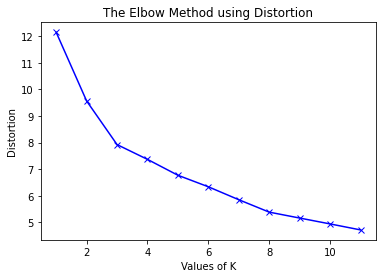

In [15]:
distortions = []
inertias = []
mapping1 = {}
mapping2 = {}
K = range(1, 12)

for k in K:
    # Building and fitting the model
    kmeanModel = KMeans(n_clusters=k).fit(adultData[['pca1', 'pca2', 'pca3']])
    kmeanModel.fit(adultData[['pca1', 'pca2', 'pca3']])
 
    distortions.append(sum(np.min(cdist(adultData[['pca1', 'pca2', 'pca3']], kmeanModel.cluster_centers_,
                                        'euclidean'), axis=1)) / adultData[['pca1', 'pca2', 'pca3']].shape[0])
    inertias.append(kmeanModel.inertia_)
 
    mapping1[k] = sum(np.min(cdist(adultData[['pca1', 'pca2', 'pca3']], kmeanModel.cluster_centers_,
                                   'euclidean'), axis=1)) / adultData[['pca1', 'pca2', 'pca3']].shape[0]
    mapping2[k] = kmeanModel.inertia_
    
    
for key, val in mapping1.items():
    print(f'{key} : {val}')

plt.plot(K, distortions, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Distortion')
plt.title('The Elbow Method using Distortion')
plt.show()

In [16]:
adultDatalabels1 =  adultDatalabels.copy()
adultData1 =  adultData[['pca1', 'pca2', 'pca3']].copy()
kmeans4 = KMeans(n_clusters=3, random_state=0).fit(adultData1)

labels = kmeans4.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print("Estimated number of clusters: %d" % n_clusters_)
print("Estimated number of noise points: %d" % n_noise_)
print("Homogeneity: %0.3f" % metrics.homogeneity_score(adultDatalabels1, labels))
print("Confusion Matrix")
print( metrics.confusion_matrix(adultDatalabels1, labels)[0] ) 
print( metrics.confusion_matrix(adultDatalabels1, labels)[1] ) 
print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(adultData1, labels))
print("Overview over the Cluster")
silluets = metrics.silhouette_samples(adultData1, labels, metric='euclidean' )
i = 0
for l in set(labels):
    print(" ")
    num = list(labels).count(l)
    print("Cluster " + str(l) + " has Size: " + str( num ) )
    print("Silluete is: " + str( silluets[i] ))
    i = i+1

Estimated number of clusters: 3
Estimated number of noise points: 0
Homogeneity: 0.131
Confusion Matrix
[9297 7065 8358]
[ 359 4893 2589]
Silhouette Coefficient: 0.350
Overview over the Cluster
 
Cluster 0 has Size: 9656
Silluete is: 0.4997618363423198
 
Cluster 1 has Size: 11958
Silluete is: 0.587197338078384
 
Cluster 2 has Size: 10947
Silluete is: 0.37108953823879054


### Visualize the clustering

In [17]:
adultData1 = adultData1.assign(label=labels)
adultData1 = adultData1.assign(true_label=adultDatalabels1)

adultData2 = adultDf.copy()

adultData2 = pd.concat([adultData2, adultData1],
                  axis = 1)

In [18]:
df = adultData2.copy()
fig = px.scatter_3d(df, x='pca1', y='pca2', z='pca3',
              color='label', symbol='true_label')
fig.show()

In [19]:
fig = px.scatter_3d(df, x='relationship', z='occupation', y='hpw',
              color='label', symbol='true_label')
fig.show()

In [20]:
df1 = pd.DataFrame({'count' : df.groupby( [ 'relationship', 'label', 'occupation', 'sex'] )['occupation'].count()}).reset_index()

In [21]:
not_normed = alt.Chart(df1).mark_bar().encode(
    alt.X('count:Q'),
    y=alt.Y('occupation:N', sort='color'),
    color='label:N',
    order=alt.Order(
      # Sort the segments of the bars by this field
      'label',
      sort='ascending'
    )
    
)

normed = alt.Chart(df1).mark_bar().encode(
    alt.X('count:Q', stack="normalize"),
    y=alt.Y('occupation:N', sort='color'),
    color='label:N',
    order=alt.Order(
      # Sort the segments of the bars by this field
      'label',
      sort='ascending'
    )
    
)

not_normed | normed

alt.HConcatChart(...)

In [22]:
not_normed = alt.Chart(df1).mark_bar().encode(
    alt.X('count:Q'),
    y=alt.Y('relationship:N', sort='color'),
    color='label:N',
    order=alt.Order(
      # Sort the segments of the bars by this field
      'label',
      sort='ascending'
    )
    
)

normed = alt.Chart(df1).mark_bar().encode(
    alt.X('count:Q', stack="normalize"),
    y=alt.Y('relationship:N', sort='color'),
    color='label:N',
    order=alt.Order(
      # Sort the segments of the bars by this field
      'label',
      sort='ascending'
    )
    
)

not_normed | normed

alt.HConcatChart(...)

In [23]:
not_normed = alt.Chart(df1).mark_bar().encode(
    alt.X('count:Q'),
    y=alt.Y('sex:N', sort='color'),
    color='label:N',
    order=alt.Order(
      # Sort the segments of the bars by this field
      'label',
      sort='ascending'
    )
    
)

normed = alt.Chart(df1).mark_bar().encode(
    alt.X('count:Q', stack="normalize"),
    y=alt.Y('sex:N', sort='color'),
    color='label:N',
    order=alt.Order(
      # Sort the segments of the bars by this field
      'label',
      sort='ascending'
    )
    
)

not_normed | normed

alt.HConcatChart(...)

In [24]:
fig = px.box(df, x='relationship', y='hpw', color='label')
fig.update_traces(quartilemethod="linear") # or "inclusive", or "linear" by default
fig.show()

In [25]:
fig = px.box(df, x='label', y='hpw')
fig.update_traces(quartilemethod="linear") # or "inclusive", or "linear" by default
fig.show()